# Post Hoc Explanation on [Bank Loan Status](https://www.kaggle.com/datasets/zaurbegiev/my-dataset) dataset

# Import dependencies

In [1]:
# general
from time import sleep
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from sklearn.metrics import accuracy_score
import seaborn as sns
from sklearn.metrics import classification_report
from sklearn import metrics
from sklearn.model_selection import train_test_split

# XGB (black box)
import xgboost as xgb

# TabNet (semi interpretable model)
from torch import optim
from pytorch_tabnet.tab_model import TabNetClassifier
# Transparent model
from interpret.glassbox import ExplainableBoostingClassifier
from interpret import show
# XAI methods
import lime
import shap
from utils.xailib.explainers.lore_explainer import LoreTabularExplainer
from utils.xailib.models.sklearn_classifier_wrapper import sklearn_classifier_wrapper
import dice_ml
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


# Data Import

The dataset has been previously pre-processed and prepared, so we can just import it.

In [2]:
# Read the train data set
df_full = pd.read_csv("data/processed/df_full.csv")
df_full.describe().T

,count,mean,std,min,25%,50%,75%,max
Loan Status,67158.0,7.560976e-01,4.294378e-01,0.0,1.00,1.000,1.000,1.000000e+00
Current Loan Amount,67158.0,1.274733e+07,3.294150e+07,15422.0,179943.50,313940.000,532064.500,1.000000e+08
Term,67158.0,7.301587e-01,4.438805e-01,0.0,0.00,1.000,1.000,1.000000e+00
Credit Score,67158.0,1.104096e+03,1.524065e+03,585.0,707.00,726.000,742.000,7.510000e+03
Annual Income,67158.0,1.376663e+06,1.132036e+06,76627.0,847134.00,1168158.000,1649409.000,1.655574e+08
Years in current job,67158.0,3.635338e+00,3.160727e+00,0.0,1.00,2.000,6.000,1.000000e+01
Home Ownership,67158.0,1.930716e+00,9.535001e-01,0.0,1.00,2.000,3.000,3.000000e+00
Purpose,67158.0,3.546934e+00,1.567391e+00,0.0,3.00,3.000,3.000,1.400000e+01
Monthly Debt,67158.0,1.839016e+04,1.218328e+04,0.0,10152.08,16127.295,23896.015,4.358433e+05
Years of Credit History,67158.0,1.821762e+01,7.007586e+00,3.6,13.50,17.000,21.700,7.050000e+01


## Black Box training

The target class is represented by the `Loan Status` feature and is the one that our model will be trained to predict

In [3]:
target = 'Loan Status'

### Data splitting

In [4]:
feature_names = df_full.columns.to_list()[1:]
test_size = 0.25
random_state = 3
X_train, X_test, Y_train, Y_test = train_test_split(df_full[feature_names], 
                                                        df_full[target],
                                                        test_size=test_size,
                                                        random_state=random_state,
                                                        stratify=df_full[target])
idtrain = X_train.index
idtest = X_test.index
train_dataset = df_full.drop(idtest,axis='index')
test_dataset = df_full.drop(idtrain,axis='index')

### Model definition and training

The black box that we have chosen for the classification is the well known XGBoost model.\
This is a tree-based model that performs well on tabular data.

In [5]:
bb = xgb.XGBClassifier(
        learning_rate=0.1,
        n_estimators=150,
        max_depth=3,
        min_child_weight=1,
        gamma=0,
        subsample=0.8,
        colsample_bytree=0.8,
        objective='binary:logistic',
        nthread=4,
        scale_pos_weight=1,
        seed=42).fit(X_train, Y_train)

### Results

In [6]:
# Make predictions on the test set
y_pred = bb.predict(X_test)

# Evaluate the performance of the classifier
accuracy = accuracy_score(Y_test, y_pred)
print(f"XGB Accuracy: {accuracy:.2%}")

XGB Accuracy: 79.85%


# Instance selection

In [9]:
# 1. Misclassified Instances
misclassified_indices = Y_test != y_pred
correctly_classified_indices = ~misclassified_indices
misclassified_instances = X_test[misclassified_indices].sample(n=1)

# 2. Low Confidence (but correct) Predictions
proba = bb.predict_proba(X_test)
# low_confidence_indices = (proba.max(axis=1) < 0.7) & misclassified_indices
low_confidence_indices = (proba.max(axis=1) < 0.7) & correctly_classified_indices
low_confidence_instances = X_test[low_confidence_indices].sample(n=3)

# 3. High Confidence (but incorrect) Predictions
# high_confidence_indices = (proba.max(axis=1) > 0.9) & (~misclassified_indices)
high_confidence_indices = (proba.max(axis=1) > 0.9) & misclassified_indices
high_confidence_instances = X_test[high_confidence_indices].sample(n=5)

# 4. Randomly Sample Remaining Instances
random_instances = X_test.sample(n=1)
 
# 5. Combine and Inspect
selected_instances = pd.concat([
    misclassified_instances,
    low_confidence_instances,
    high_confidence_instances,
    random_instances
])

inst = selected_instances
# inst = pd.read_csv("data/selected_instances.csv", index_col=0)
y_inst = df_full.iloc[inst.index][target]

In [10]:
inst

,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens
51144,390588.0,0,742.0,981977.0,1,1,3,21640.05,17.9,15.0,0.0,491074.0,905432.0,0.0,0.0
21473,163636.0,1,678.0,578075.0,4,3,3,17583.17,13.7,9.0,2.0,93081.0,211728.0,1.0,0.0
18069,223674.0,1,742.0,649059.0,3,3,4,5949.66,13.6,4.0,0.0,25061.0,58124.0,0.0,0.0
15060,111012.0,1,678.0,736231.0,3,3,7,17240.22,6.2,9.0,0.0,118142.0,233046.0,0.0,0.0
31535,175736.0,1,7270.0,574503.0,1,3,8,39523.99,28.0,12.0,0.0,369911.0,468094.0,0.0,0.0
63460,64350.0,1,746.0,422370.0,2,1,3,5019.23,28.8,15.0,0.0,38988.0,792154.0,0.0,0.0
51690,266596.0,1,746.0,1534896.0,1,1,3,1688.34,37.5,6.0,1.0,51623.0,317988.0,1.0,0.0
11991,788414.0,1,7340.0,752267.0,1,3,0,38421.80,30.9,14.0,0.0,719815.0,1673650.0,0.0,0.0
2689,655380.0,0,7090.0,1746290.0,3,3,3,27306.80,15.0,18.0,0.0,369607.0,821436.0,0.0,0.0
64071,262460.0,1,748.0,1737854.0,1,1,5,14916.71,21.5,9.0,0.0,446310.0,908226.0,0.0,0.0


# SHAP


SHAP uses game theory and shapley values to provide an explanation.

The general working of SHAP in the classical Kernel mode (default mode) is:

- Sample coalitions $z_k'\in\{0,1\}^M,\quad{}k\in\{1,\ldots,K\}$ (1 = feature present in coalition, 0 = feature absent).
- Get prediction for each $z_k'$ by first converting $z_k'$ to the original feature space and then applying model $\hat{f}: \hat{f}(h_x(z_k'))$
- Compute the weight for each $z_k'$ with the SHAP kernel.
- Fit weighted linear model.
- Return Shapley values $\phi_k$, the coefficients from the linear model.

SHAP provides several explanators, optimized for different objectives, and several visualization options.

- Kernel Explainer, it is the *real* agnostic method for computing Shap values. Hence, it works for every kind of ML model (quite slow).
- Linear Explainer, for explaining linear models. It is an exact method. It allows for an analysis with independent variables, as well as for correlated ones (you have to estimates the variables covariance matrix).
- Tree Explainer, for explaining tree-based models (tree and ensambles). Is is an exact algorithm. (Difference: conditional expectation $E_{X_j|X_{-j}}(\hat{f}(x)|x_j)$)
- Gradient Explainer, for explaining deep learning models. It is based on Integrated Gradient and it is an approximation algorithm.
- Deep Explainer, for explaining deep learning models. It is based on DEEPLift and the method computes an approximation algorithm (faster than Gradient Explainer).

In [9]:
explainer = shap.TreeExplainer(bb) 
shap_values = explainer(inst)

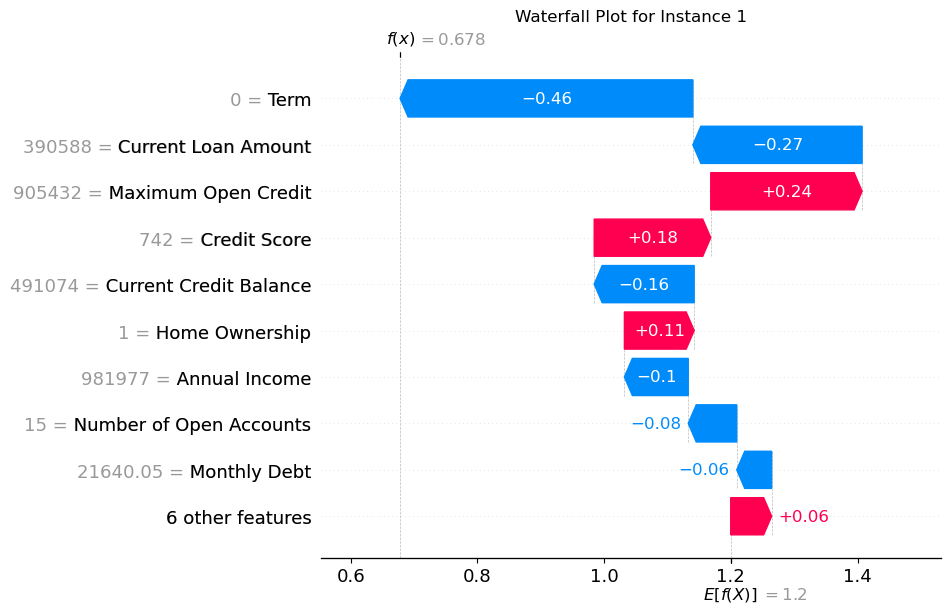

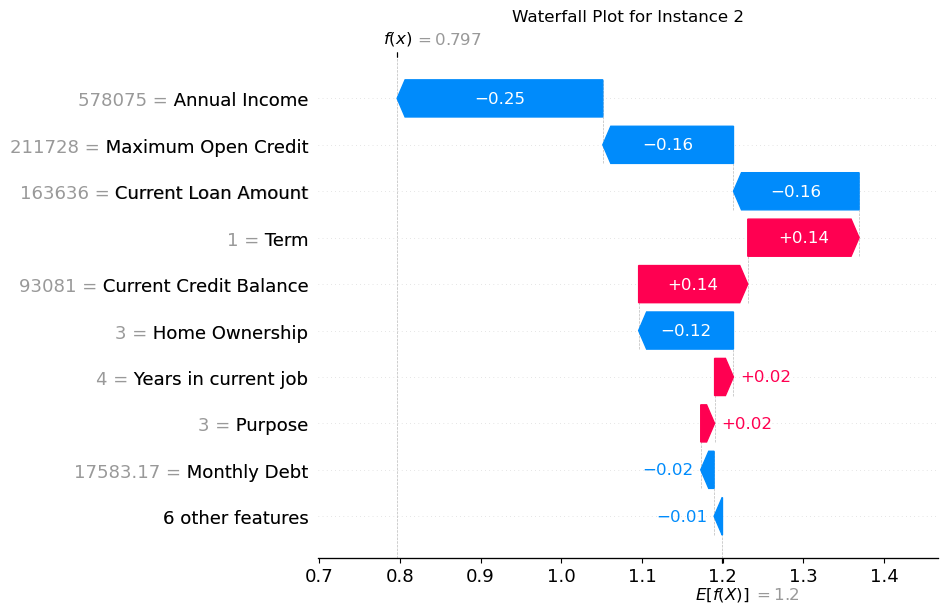

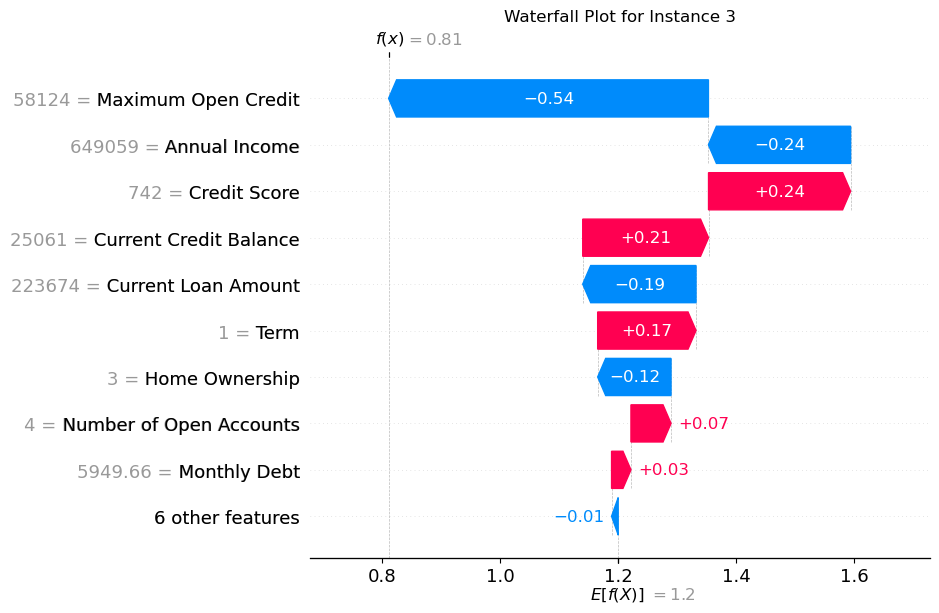

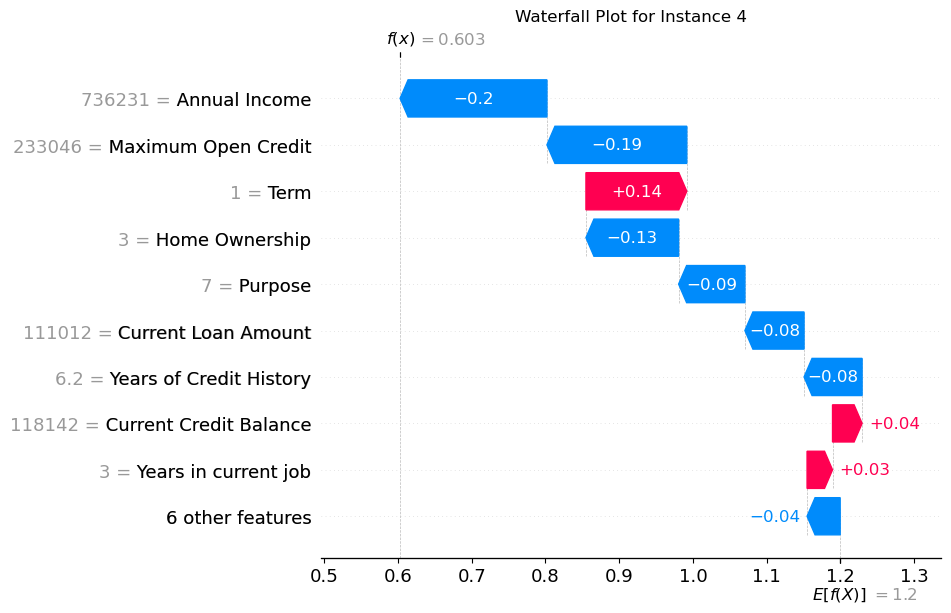

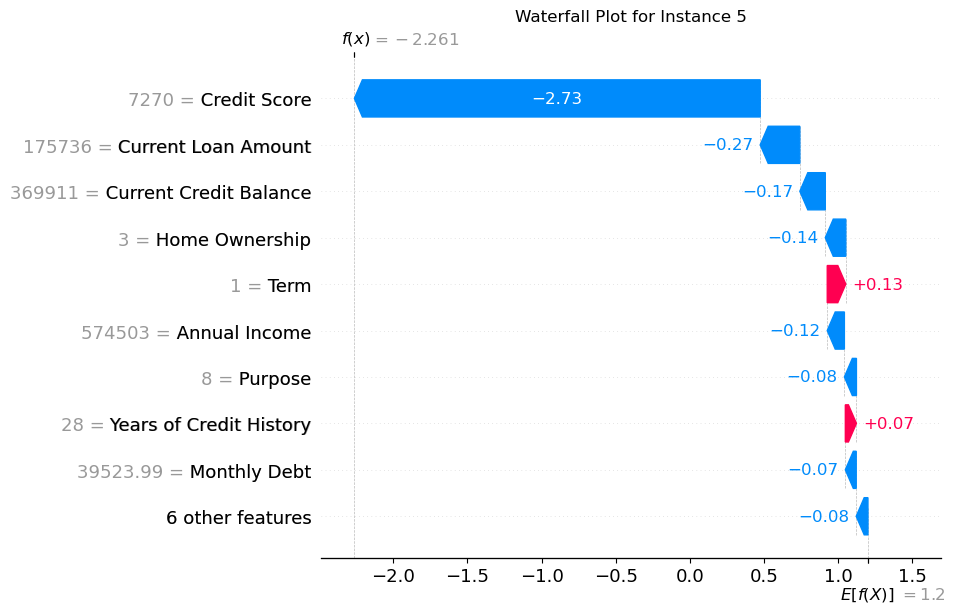

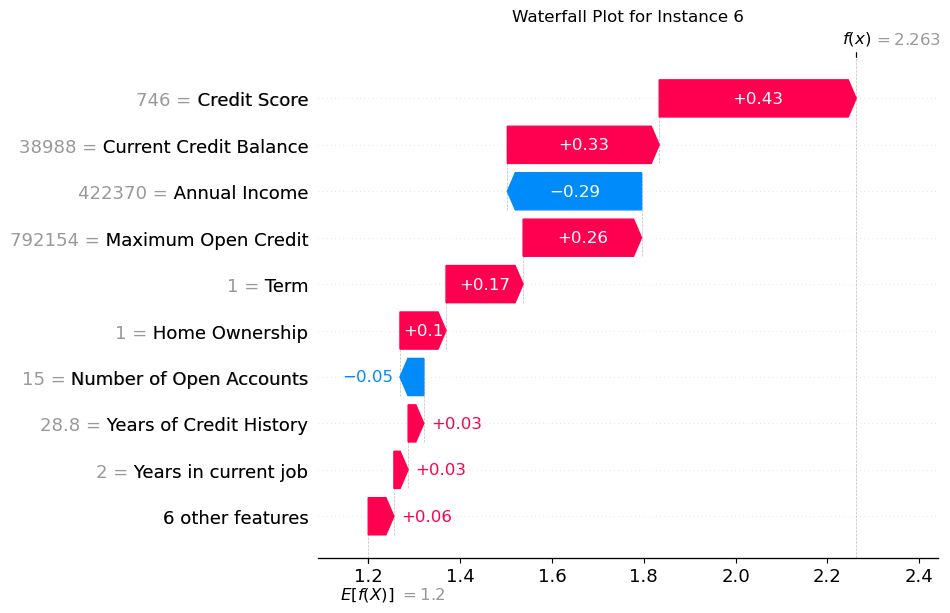

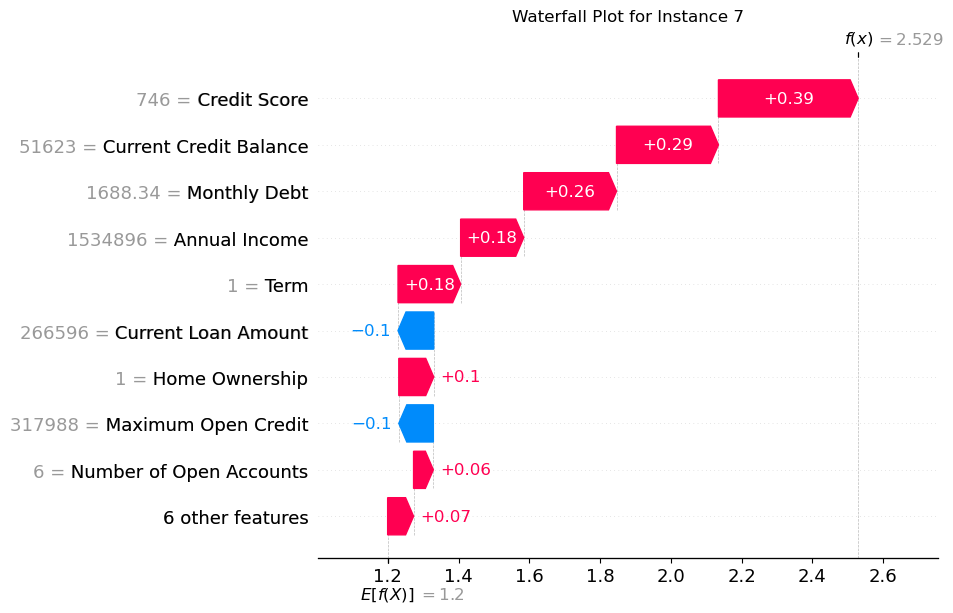

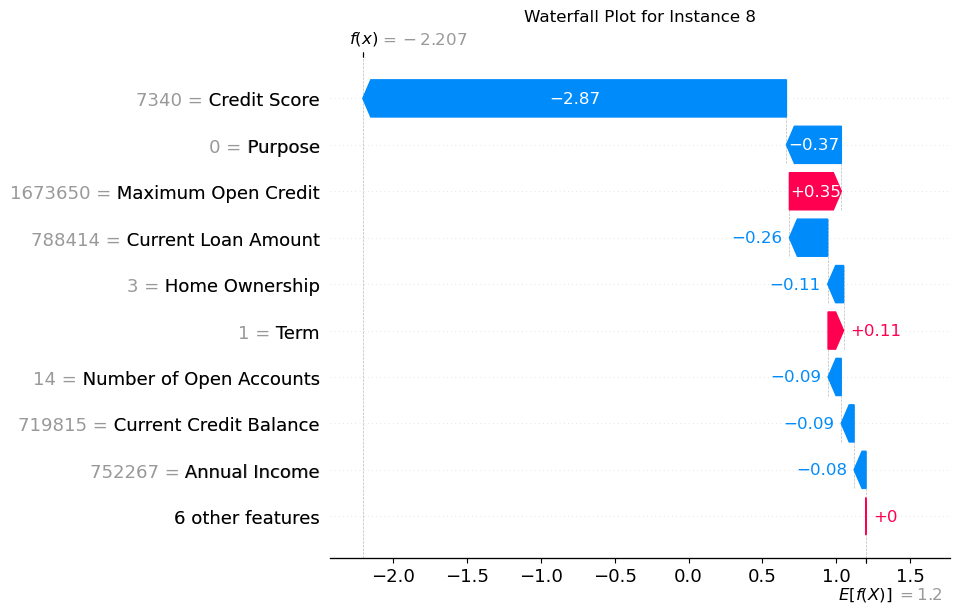

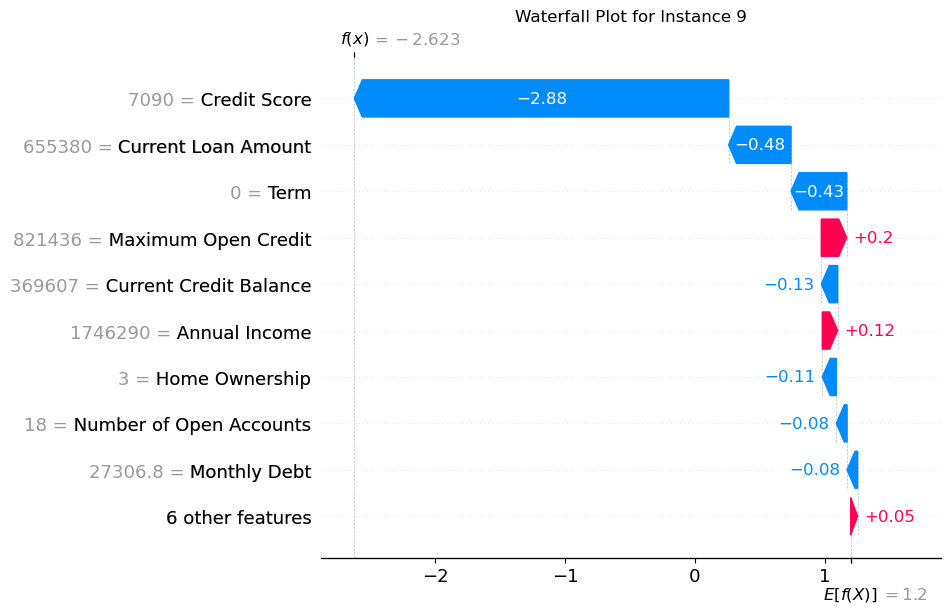

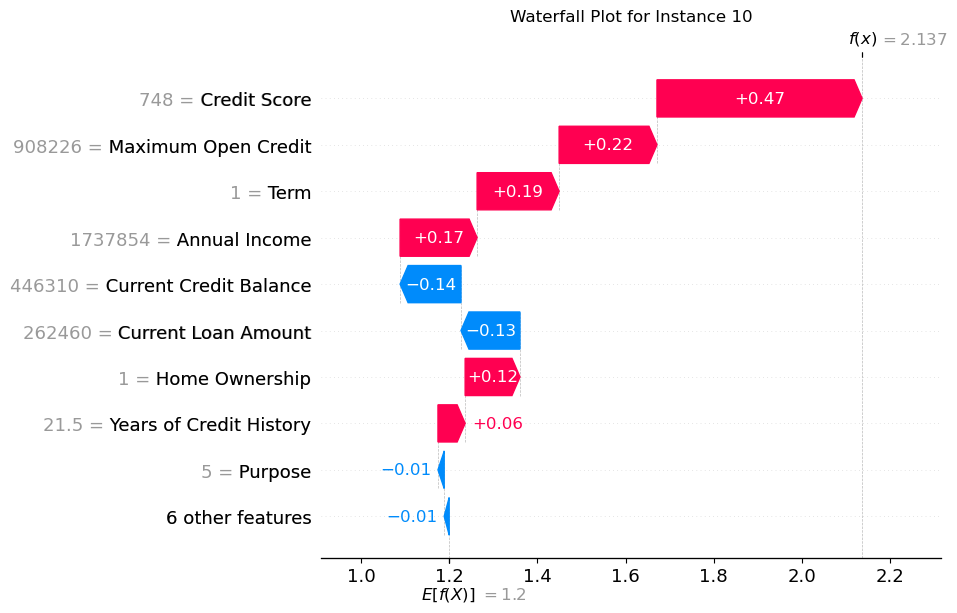

In [10]:
#shap.plots.waterfall(shap_values[0])
shap_values = explainer(inst)  # Taking the first 10 instances

# Loop through each instance and create waterfall plots
for i in range(10):
    shap.waterfall_plot(shap.Explanation(values=shap_values[i, :], base_values=explainer.expected_value, feature_names=selected_instances.columns), show=False)
    plt.title(f'Waterfall Plot for Instance {i+1}')
    plt.show()

In [11]:
#force plots
shap.initjs() #to make the visualization happen in the notebook environment
shap.plots.force(shap_values[0])

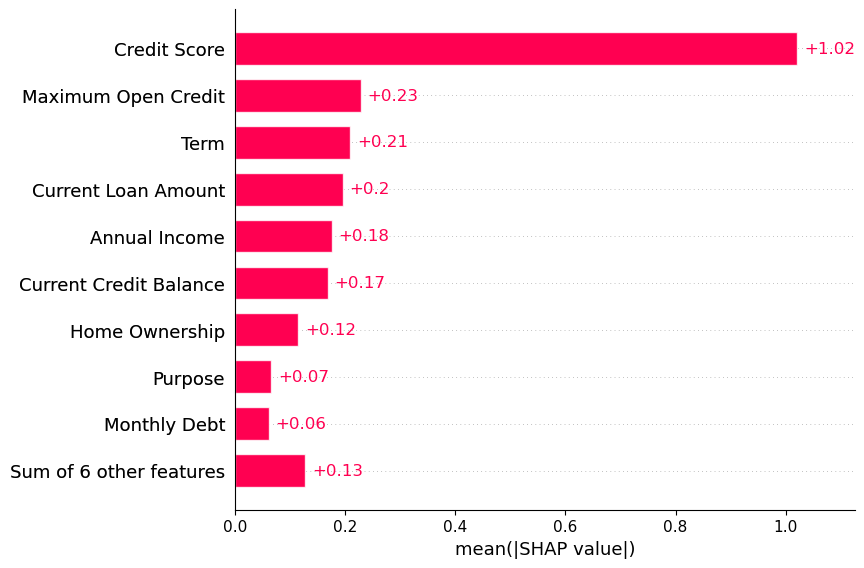

In [12]:
# Overall Analysis
#Absolute mean SHAP
shap.plots.bar(shap_values)

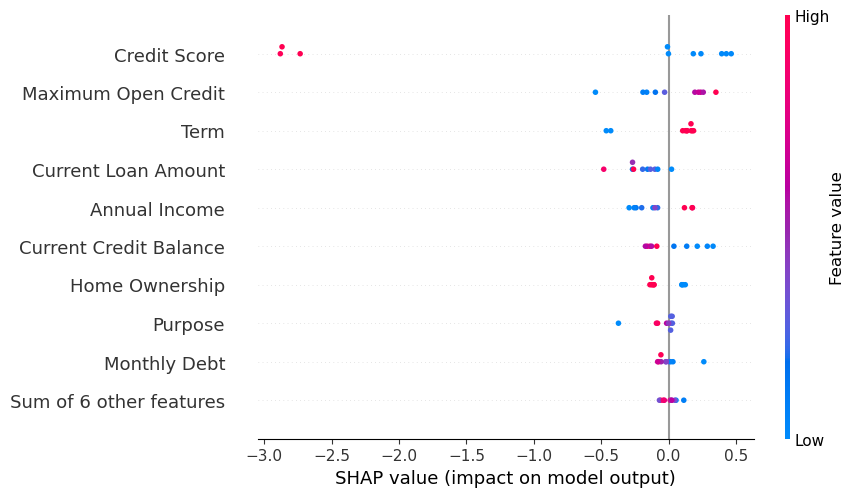

In [13]:
shap.plots.beeswarm(shap_values)

# LIME

LIME focuses on local explanations. The idea is: it generates a set of neighbours, on them it trains a linear model.

- Select your instance of interest for which you want to have an explanation of its black box prediction.
- Perturb your dataset and  get the black box predictions for these new points.
- Weight the new samples according to their proximity to the instance of interest.
- Train a weighted, interpretable model on the dataset with the variations.
- Explain the prediction by interpreting the local model.


There are 2 kinds of neighbourhood generation:

- Gaussian
- Lhs (Latin Hypercube Sampling)

We first initialize the lime explainer on our train data, providing the names of our features

In [14]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, feature_names = feature_names)

Then we can explain each data point locally
We can see each explanation from the "perspective" of the class that we want to focus on

In [15]:
for idx in range(10):
    inst_i = inst.values[idx]
    print(f"Instance {idx+1}")
    exp = explainer.explain_instance(inst_i, bb.predict_proba)
    exp.show_in_notebook(show_table=True, show_all=False)

Instance 1


Instance 2


Instance 3


Instance 4


Instance 5


Instance 6


Instance 7


Instance 8


Instance 9


Instance 10


# Lore

Lore is an algorithm developed internally to the KDDLab. To use it we will use the xai lib that we imported at the beginning. Note that shap and lime are wrappend in the xai lib, so if you want you can replicate the previous part using the xai lib.

We then use the `sklearn_classifier_wrapper` from xai lib to wrap our black box and make it ready to explain

In [11]:
bbox = sklearn_classifier_wrapper(bb)

Now e could also use the imlpementations of SHAP and Lime that are present in the XAI-lib

In [12]:
explainer = LoreTabularExplainer(bbox)

Lore uses various type of neighborhood generation to provide a local explanation based on factuals and counterfactuals

In [13]:
explainer = LoreTabularExplainer(bbox)
config = {'neigh_type':'geneticp', 'size':1000, 'ocr':0.1, 'ngen':10}
explainer.fit(train_dataset, target, config)

In [14]:
idx = 0
inst_i = inst.iloc[idx].values
print(f"Instance {idx+1}")
exp = explainer.explain(inst_i)
exp.plotRules()
sleep(1)
exp.plotCounterfactualRules()

Instance 1


In [15]:
idx = 1
inst_i = inst.iloc[idx].values
print(f"Instance {idx+1}")
exp = explainer.explain(inst_i)
exp.plotRules()
sleep(1)
exp.plotCounterfactualRules()

Instance 2


In [16]:
idx = 2
inst_i = inst.iloc[idx].values
print(f"Instance {idx+1}")
exp = explainer.explain(inst_i)
exp.plotRules()
sleep(1)
exp.plotCounterfactualRules()

Instance 3


In [17]:
idx = 3
inst_i = inst.iloc[idx].values
print(f"Instance {idx+1}")
exp = explainer.explain(inst_i)
exp.plotRules()
sleep(1)
exp.plotCounterfactualRules()

Instance 4


In [19]:
idx = 4
inst_i = inst.iloc[idx].values
print(f"Instance {idx+1}")
exp = explainer.explain(inst_i)
exp.plotRules()
sleep(1)
exp.plotCounterfactualRules()

Instance 5


In [20]:
idx = 5
inst_i = inst.iloc[idx].values
print(f"Instance {idx+1}")
exp = explainer.explain(inst_i)
exp.plotRules()
sleep(1)
exp.plotCounterfactualRules()

Instance 6


In [30]:
idx = 6
inst_i = inst.iloc[idx].values
print(f"Instance {idx+1}")
exp = explainer.explain(inst_i)
exp.plotRules()
sleep(1)
exp.plotCounterfactualRules()

Instance 7


In [25]:
idx = 7
inst_i = inst.iloc[idx].values
print(f"Instance {idx+1}")
exp = explainer.explain(inst_i)
exp.plotRules()
sleep(1)
exp.plotCounterfactualRules()

Instance 8


In [26]:
idx = 8
inst_i = inst.iloc[idx].values
print(f"Instance {idx+1}")
exp = explainer.explain(inst_i)
exp.plotRules()
sleep(1)
exp.plotCounterfactualRules()

Instance 9


In [28]:
idx = 9
inst_i = inst.iloc[idx].values
print(f"Instance {idx+1}")
exp = explainer.explain(inst_i)
exp.plotRules()
sleep(1)
exp.plotCounterfactualRules()

Instance 10


# Prorotypes through K-Means clustering

Calculating inertia: a measure of cluster cohesion that represents the sum of squared distances of data points to the centroids of their assigned clusters.
A lower inertia value indicates that data points are closer to the centroids of their clusters

In [57]:
inertia = []
for n in range(1 , 15):
    algorithm = (KMeans(n_clusters = n ,init='k-means++', n_init = 10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111  , algorithm='elkan') )
    algorithm.fit(X_train)
    inertia.append(algorithm.inertia_)

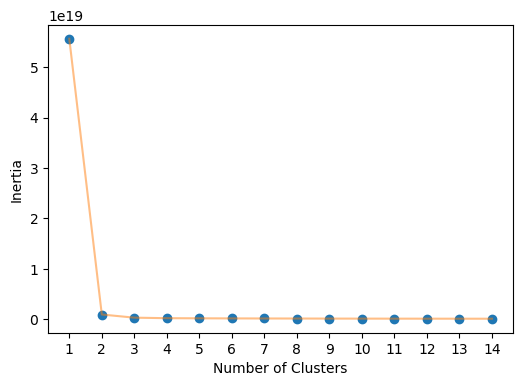

In [58]:
#visualization of inertia, which suggest the correct number of K 
plt.figure(1 , figsize = (6 ,4))
plt.plot(np.arange(1 , 15) , inertia , 'o')
plt.plot(np.arange(1 , 15) , inertia , '-' , alpha = 0.5)
plt.xticks(np.arange(1,15))
plt.xlabel('Number of Clusters') , plt.ylabel('Inertia')
plt.show()

Model definition and training

In [59]:
k_means = KMeans(n_clusters=3, init='k-means++', max_iter=300, tol=0.0001, random_state=111, algorithm='elkan')
clustering = k_means.fit(X_train)
centroids = clustering.cluster_centers_

Clusters visualization through PCA

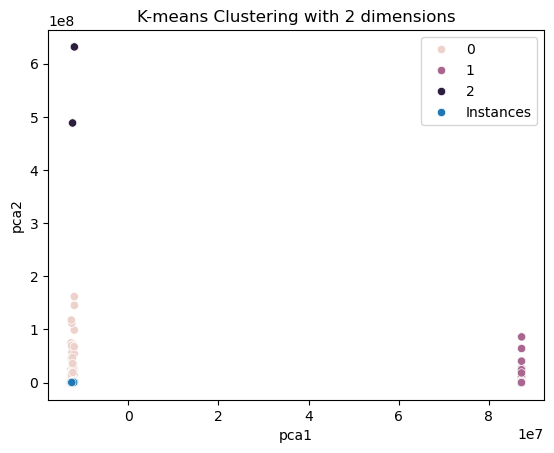

In [74]:
pca_num_components = 2

PCA_tr = PCA(n_components=pca_num_components).fit(X_train)
reduced_data = PCA_tr.transform(X_train)
results = pd.DataFrame(reduced_data,columns=['pca1','pca2'])
reduced_inst = PCA_tr.transform(inst)
results_inst = pd.DataFrame(reduced_inst,columns=['pca1','pca2'])

sns.scatterplot(x="pca1", y="pca2", hue=clustering.fit_predict(X_train), data=results)
sns.scatterplot(x="pca1", y="pca2", hue=['Instances']*10, data=results_inst, color='3')
plt.title('K-means Clustering with 2 dimensions')
plt.show()

In [78]:
y = clustering.predict(inst)
print(y)

[0 0 0 0 0 0 0 0 0 0]


In [90]:
print("Main cluster centroid:")
pd.DataFrame(centroids[0], index=feature_names).T

Main cluster centroid:


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens
0,310085.733303,0.720254,1158.373494,1.366287e+06,3.629683,1.934574,3.547124,18381.217413,18.185095,11.11533,0.163554,294132.389561,688849.478452,0.114762,0.027641


# DiCE

[DiCE](https://doi.org/10.1145/3351095.3372850) is a framework for generating and evaluating a diverse set of counterfactual explanations. The method is exogenous so, in general, returned counterfactuals are not necessary present in the original dataset. 

In [34]:
# here we convert our dataset as required by dice
numeric_columns = train_dataset.columns.to_list() # all features are numeric after preprocessing
d = dice_ml.Data(dataframe=train_dataset, continuous_features=numeric_columns[1:], outcome_name=target)

In [35]:
# Using sklearn backend
m = dice_ml.Model(model=bb, backend="sklearn")
# Using method=random for generating CFs
exp = dice_ml.Dice(d, m, method="random")

In [36]:
e1 = exp.generate_counterfactuals(inst, total_CFs=2, desired_class="opposite")
e1.visualize_as_dataframe(show_only_changes=True)

100%|██████████| 10/10 [00:02<00:00,  4.47it/s]

Query instance (original outcome : 1)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,390588.0,0,742.0,981977.0,1,1,3,21640.050781,17.9,15.0,0.0,491074.0,905432.0,0.0,0.0,1



Diverse Counterfactual set (new outcome: 0.0)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,-,-,-,-,10.0,-,-,21641.049999999985,18.0,-,-,-,-,-,4.7,0.0
1,-,-,4386.2,-,-,-,-,21641.049999999985,64.6,-,-,-,-,-,-,0.0


Query instance (original outcome : 1)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,163636.0,1,678.0,578075.0,4,3,3,17583.169922,13.7,9.0,2.0,93081.0,211728.0,1.0,0.0,1



Diverse Counterfactual set (new outcome: 0.0)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,-,0.0,-,-,-,-,-,81927.6,14.099999999999998,-,-,-,-,-,-,0.0
1,-,0.0,3576.5,-,-,-,-,17584.069999999985,14.099999999999998,-,-,-,-,-,-,0.0


Query instance (original outcome : 1)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,223674.0,1,742.0,649059.0,3,3,4,5949.660156,13.6,4.0,0.0,25061.0,58124.0,0.0,0.0,1



Diverse Counterfactual set (new outcome: 0.0)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,-,-,-,-,-,-,-,399119.3,14.099999999999998,-,-,-,-,-,6.3,0.0
1,-,-,6299.3,-,-,-,-,5950.060000000001,14.099999999999998,-,2.2,-,-,-,-,0.0


Query instance (original outcome : 1)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,111012.0,1,678.0,736231.0,3,3,7,17240.220703,6.2,9.0,0.0,118142.0,233046.0,0.0,0.0,1



Diverse Counterfactual set (new outcome: 0.0)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,-,-,7133.3,-,-,-,-,17241.01999999999,7.099999999999997,49.1,-,-,-,-,-,0.0
1,-,-,3400.1,-,-,-,-,17241.01999999999,7.099999999999997,-,-,-,-,-,-,0.0


Query instance (original outcome : 0)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,175736.0,1,7270.0,574503.0,1,3,8,39523.988281,28.0,12.0,0.0,369911.0,468094.0,0.0,0.0,0



Diverse Counterfactual set (new outcome: 1.0)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,-,-,1636.1,-,-,-,-,39524.09,-,-,-,32149356.1,-,-,-,1.0
1,-,-,2930.0,-,-,-,-,39524.09,-,-,-,11172503.6,-,-,-,1.0


Query instance (original outcome : 1)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,64350.0,1,746.0,422370.0,2,1,3,5019.22998,28.799999,15.0,0.0,38988.0,792154.0,0.0,0.0,1



Diverse Counterfactual set (new outcome: 0.0)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,-,-,4754.1,-,-,-,-,5020.0300000000025,29.000000000000004,-,-,-,-,-,9.0,0.0
1,-,-,3650.0,-,-,-,-,5020.0300000000025,29.000000000000004,-,-,24131627.8,-,-,-,0.0


Query instance (original outcome : 1)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,266596.0,1,746.0,1534896.0,1,1,3,1688.339966,37.5,6.0,1.0,51623.0,317988.0,1.0,0.0,1



Diverse Counterfactual set (new outcome: 0.0)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,-,-,4047.3,-,-,-,-,1689.0399999999993,38.00000000000001,-,-,29333412.2,-,-,-,0.0
1,-,-,5941.3,-,-,-,-,1689.0399999999993,38.00000000000001,-,-,23199339.3,-,-,-,0.0


Query instance (original outcome : 0)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,788414.0,1,7340.0,752267.0,1,3,0,38421.800781,30.9,14.0,0.0,719815.0,1673650.0,0.0,0.0,0



Diverse Counterfactual set (new outcome: 1.0)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,82220349.2,-,-,20884093.3,-,-,-,38422.0,31.0,-,-,-,-,-,-,1.0
1,76123001.6,-,-,-,-,-,-,38422.0,31.0,-,-,-,-,-,-,1.0


Query instance (original outcome : 0)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,655380.0,0,7090.0,1746290.0,3,3,3,27306.800781,15.0,18.0,0.0,369607.0,821436.0,0.0,0.0,0



Diverse Counterfactual set (new outcome: 1.0)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,-,-,2378.1,-,-,-,-,27307.099999999995,-,-,-,-,-,-,0.9,1.0
1,-,-,594.0,-,-,0.0,-,27307.099999999995,-,-,-,-,-,-,-,1.0


Query instance (original outcome : 1)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,262460.0,1,748.0,1737854.0,1,1,5,14916.709961,21.5,9.0,0.0,446310.0,908226.0,0.0,0.0,1



Diverse Counterfactual set (new outcome: 0.0)


,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens,Loan Status
0,-,-,5814.1,-,-,-,-,14917.01,22.000000000000007,-,-,-,-,-,-,0.0
1,-,-,4713.1,-,-,-,-,14917.01,22.000000000000007,-,3.1,-,-,-,-,0.0


# TabNet

Moving towards interpretable models, we propose [TabNet](https://doi.org/10.48550/arXiv.1908.07442): a Deep Neural Network (DNN) model specifically built for tabular data able to provide both quite good performance and suggestions for the interpretation of the results.

The model reaches very good accuracy scores that can compete and even outperform more standard state-of-the-art classification models (e.g. tree-based models like XGB). The training of this model (and training of a genereal DNN) is tipically slower with respect to the non NN-based ones, but it has two interesting advantages: 
1. Including a specific self-attention module that can be interpreted as a built-in feature relevance provider enabling local interpretability that visualizes the importance of features and how they are combined, and global interpretability which quantifies the contribution of each feature to the trained mode
2. All the processing steps tipically needed for mixed numeric/categorical tabular dataset are built-in in the TabNet encoder, so raw dataset can be directly feeded into the model

## Model definition and training

Even if TabNet can work on raw (unprocessed) tabular dataset, we provide our processed dataset for better performance comparison with XGB 

In [31]:
# model definition
tabnet_clf = TabNetClassifier(
    optimizer_fn=optim.Adam,
    optimizer_params=dict(lr=2e-2),
    scheduler_params={"step_size":10, # how to use learning rate scheduler
                      "gamma":0.9},
    scheduler_fn=optim.lr_scheduler.StepLR,
    mask_type='sparsemax' # This will be overwritten if using pretrain model
)
# training
tabnet_clf.fit(
    X_train=X_train.values, y_train=Y_train.values,
    max_epochs=100
)

epoch 0  | loss: 0.52686 |  0:00:01s
epoch 1  | loss: 0.4733  |  0:00:03s
epoch 2  | loss: 0.46414 |  0:00:04s
epoch 3  | loss: 0.46209 |  0:00:06s
epoch 4  | loss: 0.46225 |  0:00:07s
epoch 5  | loss: 0.46031 |  0:00:09s
epoch 6  | loss: 0.46061 |  0:00:10s
epoch 7  | loss: 0.46078 |  0:00:12s
epoch 8  | loss: 0.46028 |  0:00:13s
epoch 9  | loss: 0.45999 |  0:00:15s
epoch 10 | loss: 0.45867 |  0:00:16s
epoch 11 | loss: 0.45803 |  0:00:18s
epoch 12 | loss: 0.45733 |  0:00:20s
epoch 13 | loss: 0.45706 |  0:00:21s
epoch 14 | loss: 0.45644 |  0:00:23s
epoch 15 | loss: 0.45833 |  0:00:24s
epoch 16 | loss: 0.45681 |  0:00:26s
epoch 17 | loss: 0.45587 |  0:00:27s
epoch 18 | loss: 0.4556  |  0:00:29s
epoch 19 | loss: 0.45623 |  0:00:30s
epoch 20 | loss: 0.45661 |  0:00:32s
epoch 21 | loss: 0.45498 |  0:00:33s
epoch 22 | loss: 0.45597 |  0:00:35s
epoch 23 | loss: 0.45649 |  0:00:36s
epoch 24 | loss: 0.45524 |  0:00:38s
epoch 25 | loss: 0.45556 |  0:00:39s
epoch 26 | loss: 0.45549 |  0:00:41s
e

## Results

In [32]:
preds = tabnet_clf.predict(X_test.values)
print(f"TabNet Accuracy: {accuracy_score(Y_test, preds):.2%}")

TabNet Accuracy: 79.80%


In [53]:
selected_preds = tabnet_clf.predict(inst.values)
print(f"Instances classes:  {y_inst.tolist()}")
print(f"Prediction classes: {selected_preds.tolist()}")

Instances classes:  [0, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Prediction classes: [1, 1, 1, 1, 0, 1, 1, 0, 0, 1]


## TabNet built-in interpretations

Even if TabNet is not a glassbox (completely transparent) model, it provides some kind of feature relevance, based on attention

In [33]:
# global explanation
g_TabNet_fr = tabnet_clf.feature_importances_
TabNet_fr = tabnet_clf._compute_feature_importances(inst.values)

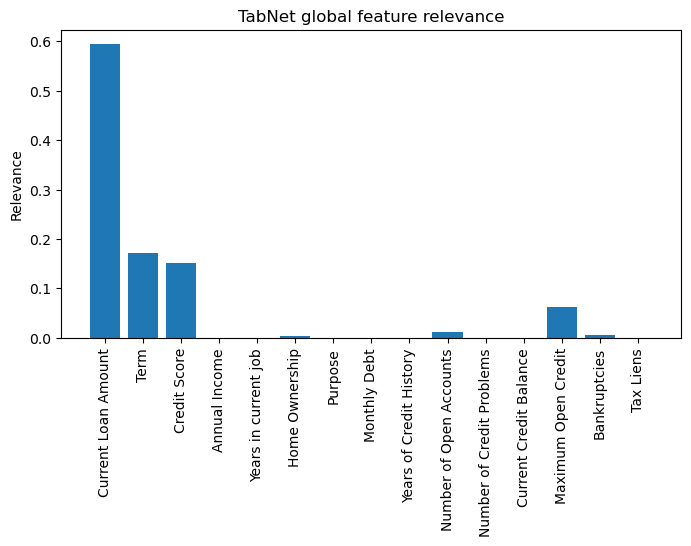

In [41]:
fig, ax = plt.subplots(1, 1, figsize=(8,4))
plt.title('TabNet global feature relevance')
ax.set_ylabel('Relevance')
ax.bar(np.arange(15), g_TabNet_fr)
ax.set_xticks(np.arange(15))
ax.set_xticklabels(feature_names, rotation=90)
plt.show()

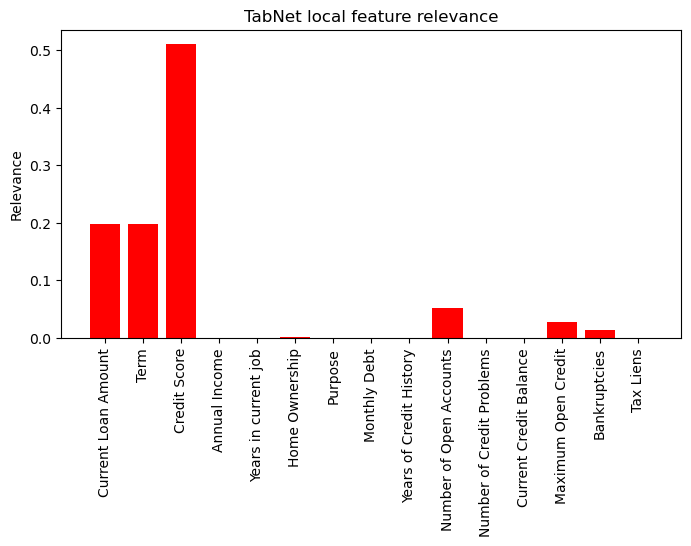

In [43]:
fig, ax = plt.subplots(1, 1, figsize=(8,4))
plt.title('TabNet local feature relevance')
ax.set_ylabel('Relevance')
ax.bar(np.arange(15), TabNet_fr, color = 'red')
ax.set_xticks(np.arange(15))
ax.set_xticklabels(feature_names, rotation=90)
plt.show()

In [44]:
explain_matrix, masks = tabnet_clf.explain(inst.values)

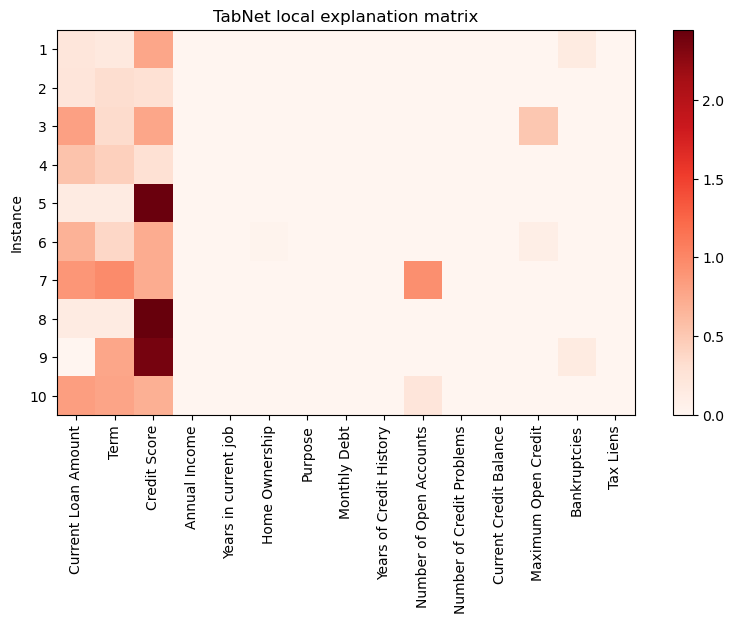

In [45]:
fig, ax = plt.subplots(1, 1, figsize=(10,5))
im = ax.imshow(explain_matrix, cmap='Reds')
plt.title('TabNet local explanation matrix')
ax.set_ylabel('Instance')
ax.set_yticks(np.arange(10))
ax.set_yticklabels(np.arange(10)+1)
ax.set_xticks(np.arange(15))
ax.set_xticklabels(feature_names, rotation=90)
fig.colorbar(im)
plt.show()

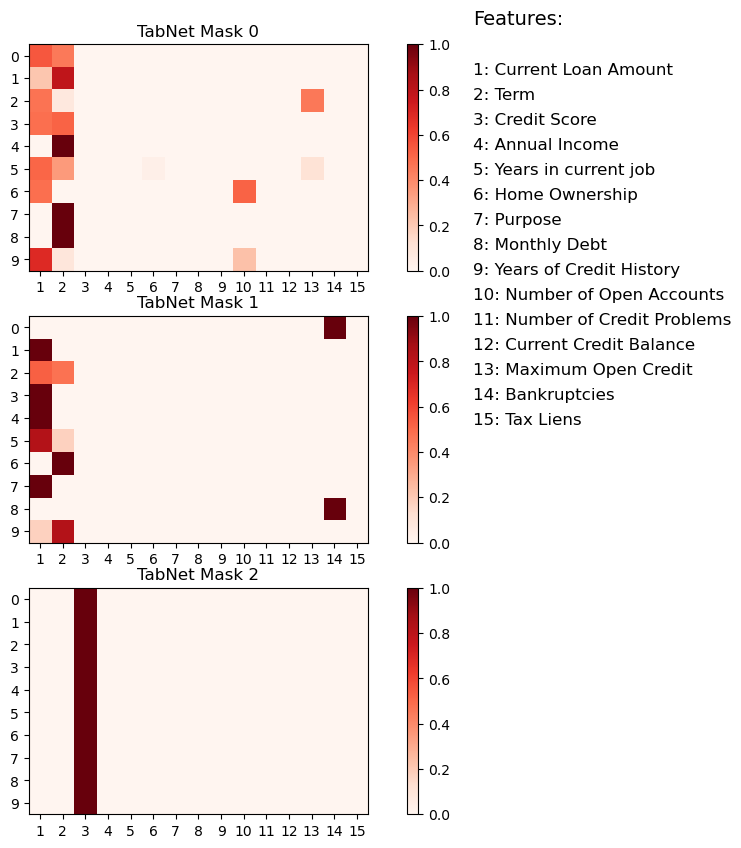

In [46]:
fig, axs = plt.subplots(3, 1, figsize=(10,10))
# fig.set_title("TabNet Feaure selection")
plt.gcf().text(0.85, 0.9, 'Features:', fontsize=14)
for h in range(15):
    plt.gcf().text(0.85, 0.85-h/40, f'{h+1}: {feature_names[h]}', fontsize=12)
for i in range(3):
    im = axs[i].imshow(masks[i], cmap='Reds')
    axs[i].set_title(f"TabNet Mask {i}")
    axs[i].set_yticks(np.arange(10))
    axs[i].set_xticks(np.arange(15))
    axs[i].set_xticklabels(labels = np.arange(1,16))
    fig.colorbar(im, orientation='vertical')

# EBM

### Additional import

In [43]:
from interpret.provider import InlineProvider
from interpret import set_visualize_provider

set_visualize_provider(InlineProvider())

### Model definition and training

In [54]:
ebm = ExplainableBoostingClassifier(feature_names=feature_names)
ebm.fit(X_train, Y_train)

ExplainableBoostingClassifier(feature_names=['Current Loan Amount', 'Term',
                                             'Credit Score', 'Annual Income',
                                             'Years in current job',
                                             'Home Ownership', 'Purpose',
                                             'Monthly Debt',
                                             'Years of Credit History',
                                             'Number of Open Accounts',
                                             'Number of Credit Problems',
                                             'Current Credit Balance',
                                             'Maximum Open Credit',
                                             'Bankruptcies', 'Tax Liens'])

### Results

In [55]:
y_pred_ebm = ebm.predict(X_test)
accuracy_ebm = accuracy_score(Y_test, y_pred_ebm)
print(f"EBM Accuracy: {accuracy_ebm:.2%}")

EBM Accuracy: 79.82%


In [56]:
selected_preds = ebm.predict(inst)
print(f"Instances classes:  {y_inst.tolist()}")
print(f"Prediction classes: {selected_preds.tolist()}")

Instances classes:  [0, 1, 1, 1, 1, 0, 0, 1, 1, 1]
Prediction classes: [1, 1, 1, 1, 0, 1, 1, 0, 0, 1]


## EBM explanations

In [46]:
show(ebm.explain_global())

In [47]:
exp = ebm.explain_local(inst, y_inst)

In [48]:
show(exp)